# YOLOv11n Model Inference and Visualization

## Objective
Evaluate the trained YOLOv11n model (augmented dataset baseline) on the Black bean test set and generate comprehensive visualizations and performance metrics.

---

## 1. Setup & Imports

In [1]:
import ultralytics
print("Ultralytics version:", ultralytics.__version__)

from ultralytics import YOLO
from pathlib import Path
from IPython.display import Image, display
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image as PILImage
import cv2
import json
import random
from collections import defaultdict
import yaml

# Disable MLflow
ultralytics.settings.update({'mlflow': False})

print("Libraries imported successfully")

# Set random seed for reproducibility
random.seed(42)
np.random.seed(42)

Ultralytics version: 8.3.226
Libraries imported successfully


## 2. Configuration

In [2]:
# Dataset Configuration
CROP_TYPE = "Black bean"

DATASET_ROOT = Path("Weed-crop RGB dataset")
DATASET_DIR = DATASET_ROOT / f"{CROP_TYPE}_augmented"
DATA_CONFIG = DATASET_DIR / f"{CROP_TYPE.lower()}_augmented.yaml"

# Load the BEST model (Augmented Baseline from Notebook 02)
MODEL_PATH = Path("runs") / f"{CROP_TYPE}_augmented" / "weights" / "best.pt"

# Test images directory
TEST_DIR = DATASET_DIR / "test"

# Output directory for visualizations
OUTPUT_DIR = Path("inference_results")
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

# Visualization settings
CONF_THRESHOLD = 0.25  # Confidence threshold for displaying predictions
IMG_SIZE = 640

CLASSES_FILE = DATASET_DIR / "classes.txt"

print(f"\n{'='*60}")
print("INFERENCE CONFIGURATION")
print(f"{'='*60}")
print(f"Dataset: {CROP_TYPE}_augmented")
print(f"Model: {MODEL_PATH}")
print(f"Test images: {TEST_DIR}")
print(f"Output directory: {OUTPUT_DIR}")
print(f"Confidence threshold: {CONF_THRESHOLD}")
print(f"{'='*60}\n")

# Validate paths
assert MODEL_PATH.exists(), f"Model not found: {MODEL_PATH}"
assert TEST_DIR.exists(), f"Test directory not found: {TEST_DIR}"
assert CLASSES_FILE.exists(), f"Classes file not found: {CLASSES_FILE}"

print(" All paths validated")


INFERENCE CONFIGURATION
Dataset: Black bean_augmented
Model: runs/Black bean_augmented/weights/best.pt
Test images: Weed-crop RGB dataset/Black bean_augmented/test
Output directory: inference_results
Confidence threshold: 0.25

 All paths validated


## 3. Load Model & Class Names

In [3]:
# Load class names
with open(CLASSES_FILE, 'r') as f:
    class_list = [line.strip() for line in f if line.strip()]

CLASS_NAMES = {i: name for i, name in enumerate(class_list)}
NUM_CLASSES = len(CLASS_NAMES)

print(f"Dataset: {NUM_CLASSES} classes")
for idx, name in CLASS_NAMES.items():
    print(f"  [{idx}] {name}")

# Load the trained model
print(f"\nLoading model from: {MODEL_PATH}")
model = YOLO(MODEL_PATH)

print("\n" + "="*60)
print("MODEL LOADED SUCCESSFULLY")
print("="*60)
print(f"Model: YOLOv11n")
print(f"Training: Augmented dataset (Notebook 02)")
print(f"Performance: mAP@0.5 = 0.3597, Recall = 0.4183")
print("="*60)

Dataset: 13 classes
  [0] Black bean
  [1] Canola
  [2] Corn
  [3] Field Pea
  [4] Flax
  [5] Horseweed
  [6] Kochia
  [7] Lentil
  [8] Ragweed
  [9] Redroot Pigweed
  [10] Soybean
  [11] Sugar beet
  [12] Waterhemp

Loading model from: runs/Black bean_augmented/weights/best.pt

MODEL LOADED SUCCESSFULLY
Model: YOLOv11n
Training: Augmented dataset (Notebook 02)
Performance: mAP@0.5 = 0.3597, Recall = 0.4183


## 4. Get Test Images

In [4]:
# Get all test images (support both lowercase and uppercase extensions)
test_images = (list(TEST_DIR.glob("*.jpg")) + 
               list(TEST_DIR.glob("*.JPG")) + 
               list(TEST_DIR.glob("*.png")) + 
               list(TEST_DIR.glob("*.PNG")))

# Filter out .txt files (labels) just in case
test_images = [img for img in test_images if img.suffix.lower() in ['.jpg', '.png', '.jpeg']]

print(f"Found {len(test_images)} test images")

if len(test_images) == 0:
    print("No test images found! Check dataset structure.")
else:
    print(f"\nSample images:")
    for img in test_images[:5]:
        print(f"  - {img.name}")

Found 39 test images

Sample images:
  - field_1647573223394_1283.JPG
  - field_1647568975934_350.JPG
  - field_cas22_1657835267159_15.JPG
  - field_1660569616727_6.JPG
  - field_1647568310580_12.JPG


## 5. Run Inference on Sample Images

In [5]:
# Select random sample images for visualization
NUM_SAMPLES = min(10, len(test_images))
sample_images = random.sample(test_images, NUM_SAMPLES)

print(f"Running inference on {NUM_SAMPLES} sample images...\n")

# Run predictions
results_list = []

for img_path in sample_images:
    print(f"Processing: {img_path.name}")
    
    # Run inference
    results = model.predict(
        source=str(img_path),
        imgsz=IMG_SIZE,
        conf=CONF_THRESHOLD,
        save=False,
        verbose=False
    )
    
    results_list.append({
        'path': img_path,
        'results': results[0]
    })
    
    # Print detection summary
    boxes = results[0].boxes
    if len(boxes) > 0:
        classes_detected = [int(c) for c in boxes.cls]
        class_counts = pd.Series(classes_detected).value_counts()
        print(f"  Detected {len(boxes)} objects:")
        for cls_id, count in class_counts.items():
            print(f"    - {CLASS_NAMES[cls_id]}: {count}")
    else:
        print(f"  No objects detected")
    print()

print(f" Inference completed on {len(results_list)} images")

Running inference on 10 sample images...

Processing: field_1647568597538_303.JPG
  Detected 12 objects:
    - Black bean: 8
    - Redroot Pigweed: 3
    - Waterhemp: 1

Processing: field_1647568975934_350.JPG
  Detected 9 objects:
    - Black bean: 5
    - Redroot Pigweed: 2
    - Waterhemp: 1
    - Kochia: 1

Processing: field_1647575411061_1382.JPG
  Detected 20 objects:
    - Black bean: 11
    - Ragweed: 4
    - Waterhemp: 3
    - Horseweed: 2

Processing: field_1660674093136_45.JPG
  Detected 29 objects:
    - Black bean: 26
    - Waterhemp: 3

Processing: field_cas22_1657835681654_19.JPG
  Detected 30 objects:
    - Black bean: 25
    - Ragweed: 3
    - Waterhemp: 2

Processing: field_1647573224412_1284.JPG
  Detected 18 objects:
    - Black bean: 10
    - Waterhemp: 3
    - Kochia: 2
    - Ragweed: 2
    - Redroot Pigweed: 1

Processing: field_1647570655456_573.JPG
  Detected 12 objects:
    - Black bean: 6
    - Horseweed: 3
    - Waterhemp: 1
    - Kochia: 1
    - Ragweed: 1


## 6. Visualize Predictions with Bounding Boxes


VISUALIZATION: PREDICTIONS WITH BOUNDING BOXES

Saved: inference_results/visualizations/pred_field_1647568597538_303.png


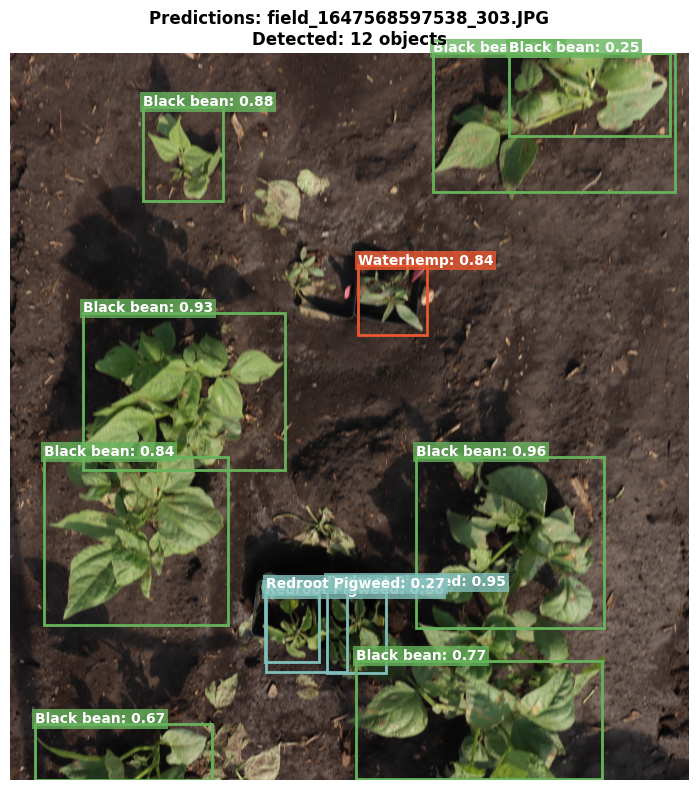

Saved: inference_results/visualizations/pred_field_1647568975934_350.png


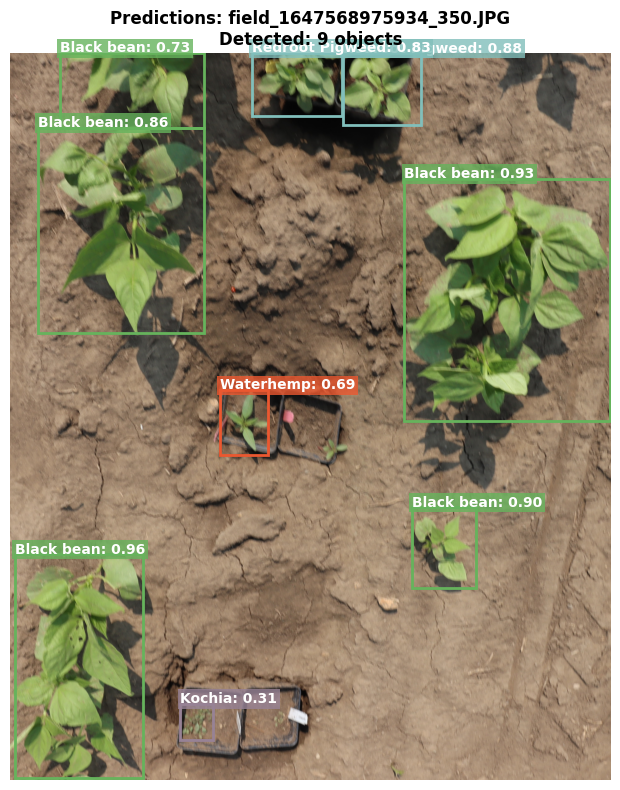

Saved: inference_results/visualizations/pred_field_1647575411061_1382.png


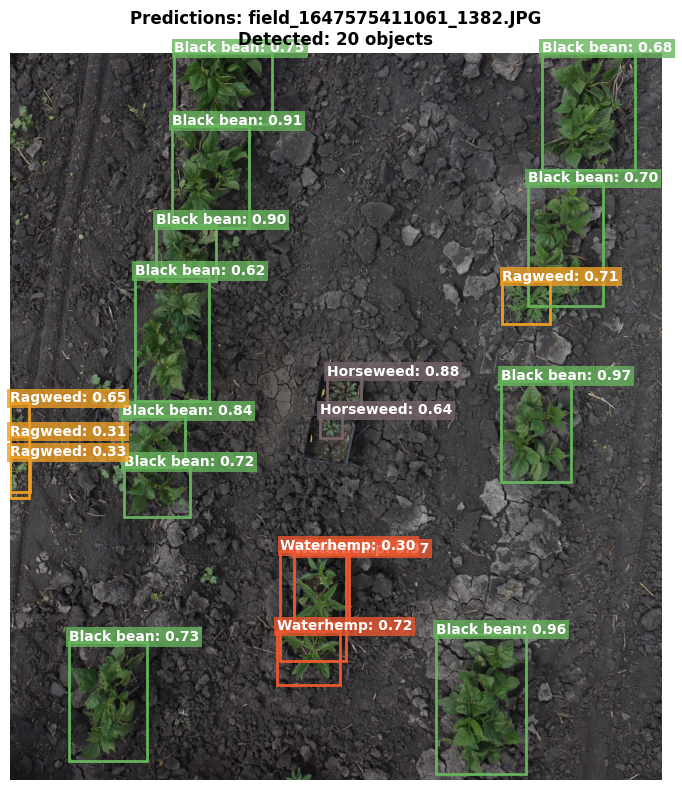

Saved: inference_results/visualizations/pred_field_1660674093136_45.png


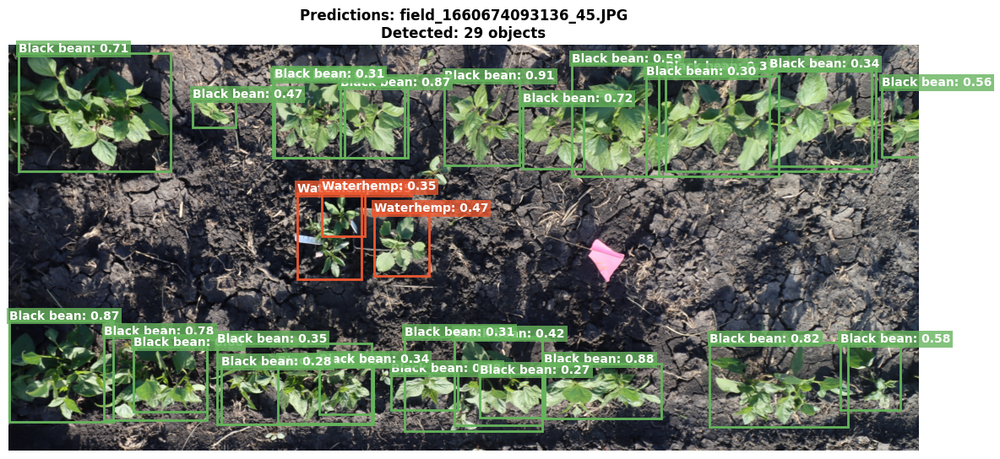

Saved: inference_results/visualizations/pred_field_cas22_1657835681654_19.png


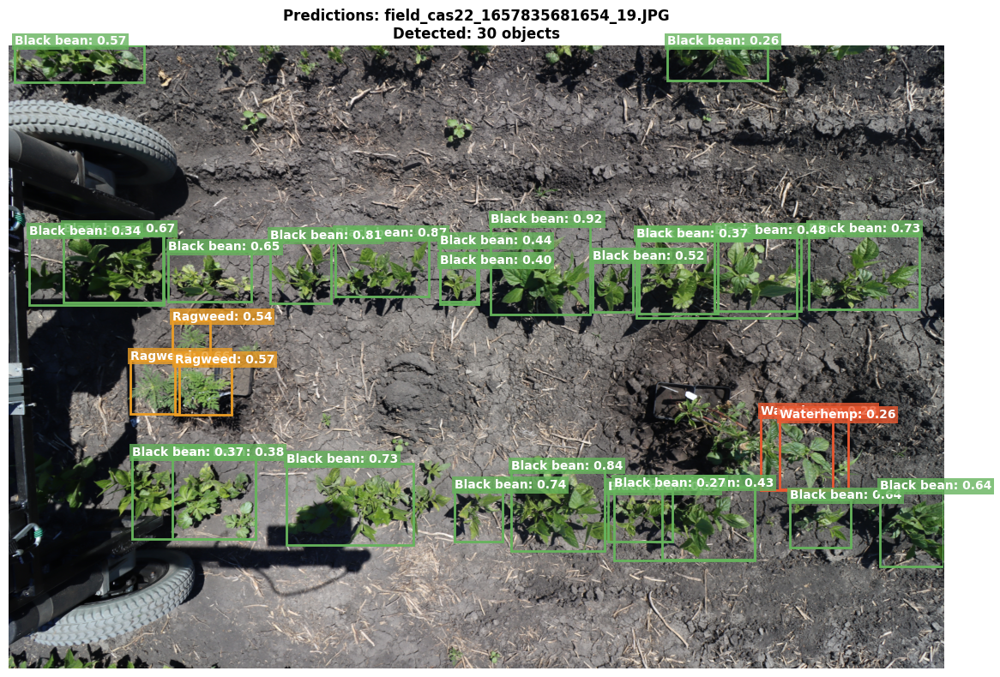

Saved: inference_results/visualizations/pred_field_1647573224412_1284.png


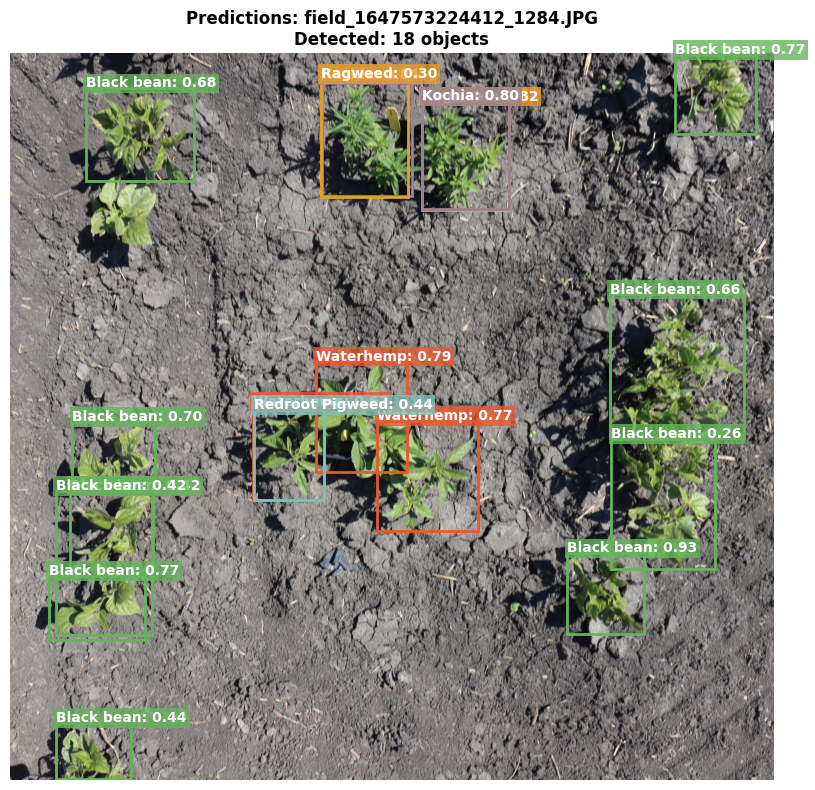

Saved: inference_results/visualizations/pred_field_1647570655456_573.png


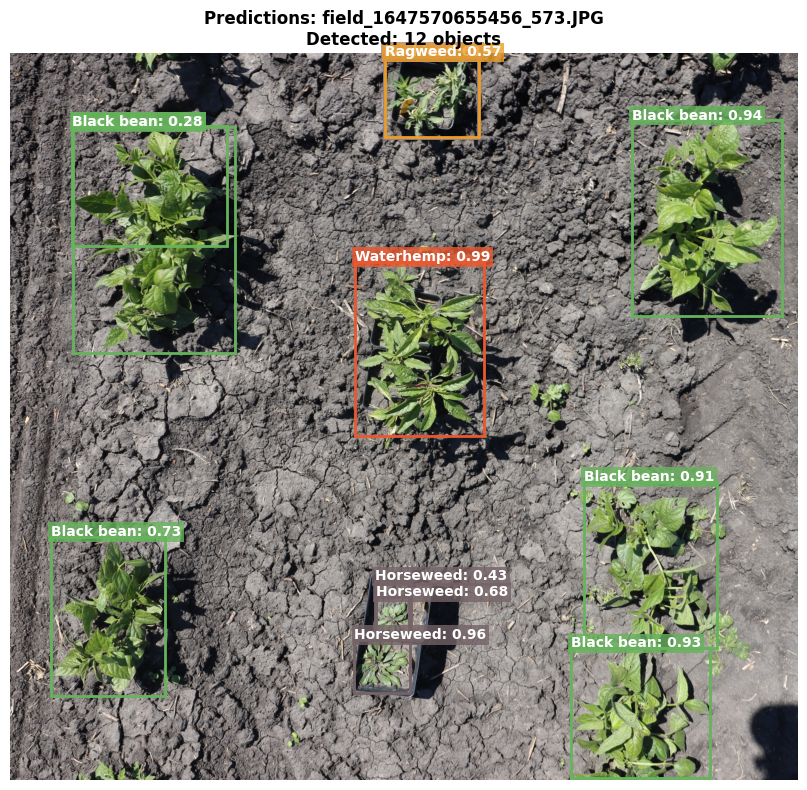

Saved: inference_results/visualizations/pred_field_cas22_1657833308148_28.png


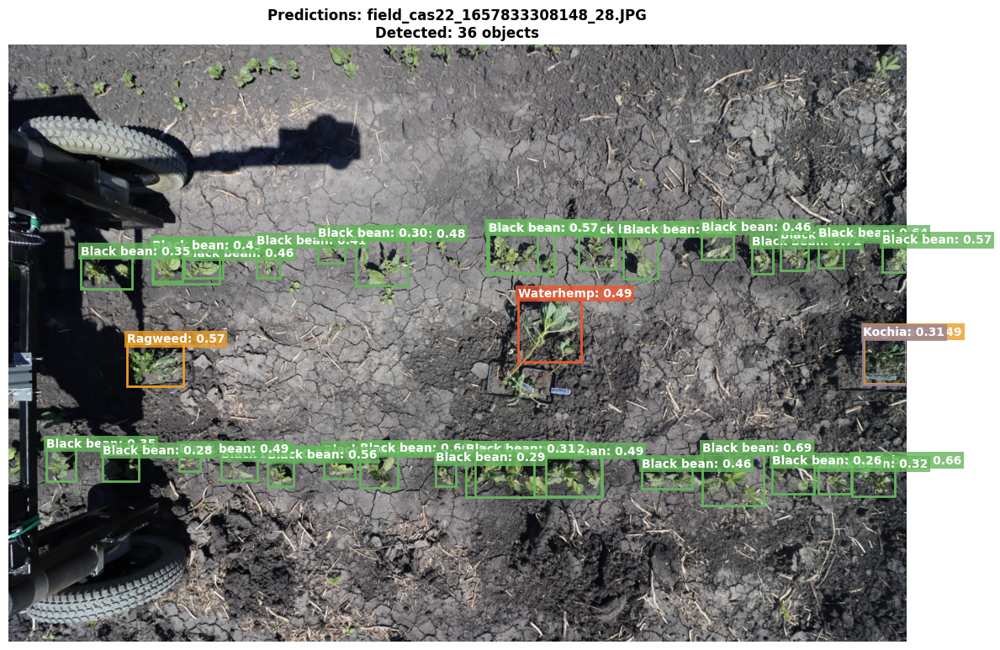

Saved: inference_results/visualizations/pred_field_1647575412039_1383.png


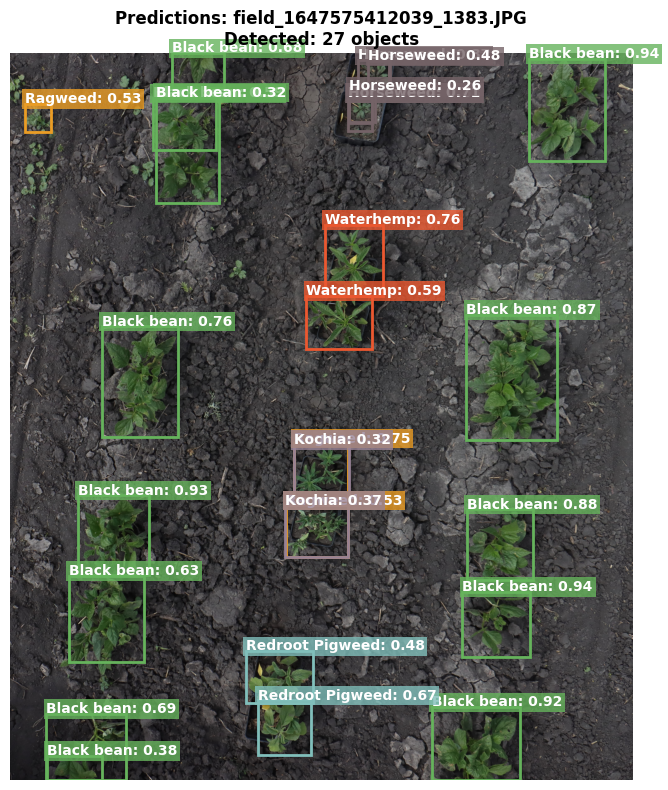

Saved: inference_results/visualizations/pred_field_1660674011400_23.png


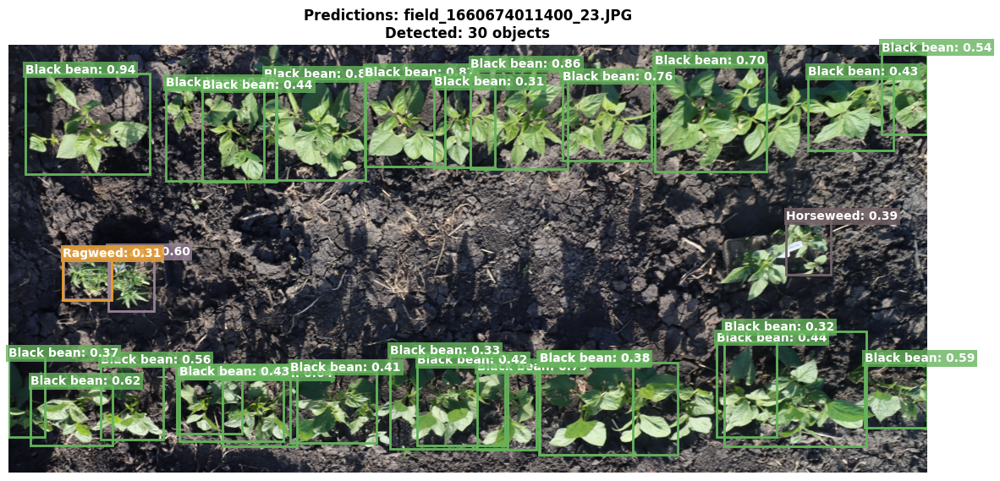


 All visualizations saved to: inference_results/visualizations


In [6]:
def visualize_predictions(img_path, result, class_names, save_dir=None):
    """
    Visualize predictions with bounding boxes and labels.
    """
    # Load image
    img = cv2.imread(str(img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    fig, ax = plt.subplots(1, 1, figsize=(12, 8))
    ax.imshow(img)
    
    # Get predictions
    boxes = result.boxes
    
    if len(boxes) > 0:
        # Generate colors for each class
        np.random.seed(42)
        colors = {i: tuple(np.random.randint(0, 255, 3) / 255) for i in class_names.keys()}
        
        for box in boxes:
            # Get box coordinates
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
            conf = float(box.conf[0])
            cls = int(box.cls[0])
            
            # Draw rectangle
            rect = patches.Rectangle(
                (x1, y1), x2 - x1, y2 - y1,
                linewidth=2,
                edgecolor=colors[cls],
                facecolor='none'
            )
            ax.add_patch(rect)
            
            # Add label
            label = f"{class_names[cls]}: {conf:.2f}"
            ax.text(
                x1, y1 - 5,
                label,
                color='white',
                fontsize=10,
                fontweight='bold',
                bbox=dict(facecolor=colors[cls], alpha=0.8, edgecolor='none', pad=2)
            )
    
    ax.set_title(f"Predictions: {img_path.name}\nDetected: {len(boxes)} objects", 
                 fontsize=12, fontweight='bold')
    ax.axis('off')
    
    plt.tight_layout()
    
    if save_dir:
        save_path = save_dir / f"pred_{img_path.stem}.png"
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"Saved: {save_path}")
    
    plt.show()


# Visualize all sample predictions
print("\n" + "="*60)
print("VISUALIZATION: PREDICTIONS WITH BOUNDING BOXES")
print("="*60 + "\n")

vis_dir = OUTPUT_DIR / "visualizations"
vis_dir.mkdir(exist_ok=True)

for item in results_list:
    visualize_predictions(
        item['path'], 
        item['results'], 
        CLASS_NAMES,
        save_dir=vis_dir
    )

print(f"\n All visualizations saved to: {vis_dir}")

## 7. Per-Class Detection Examples

In [7]:
# Organize detections by class
class_examples = defaultdict(list)

for item in results_list:
    boxes = item['results'].boxes
    if len(boxes) > 0:
        for box in boxes:
            cls = int(box.cls[0])
            conf = float(box.conf[0])
            class_examples[cls].append({
                'image': item['path'],
                'confidence': conf,
                'box': box
            })

# Print summary
print("\n" + "="*60)
print("PER-CLASS DETECTION SUMMARY")
print("="*60 + "\n")

detection_summary = []
for cls_id in sorted(class_examples.keys()):
    examples = class_examples[cls_id]
    avg_conf = np.mean([e['confidence'] for e in examples])
    detection_summary.append({
        'Class': CLASS_NAMES[cls_id],
        'Detections': len(examples),
        'Avg Confidence': avg_conf,
        'Images': len(set(e['image'] for e in examples))
    })

df_summary = pd.DataFrame(detection_summary)
if len(df_summary) > 0:
    df_summary = df_summary.sort_values('Detections', ascending=False)
    display(df_summary)
    
    # Save summary
    df_summary.to_csv(OUTPUT_DIR / "detection_summary.csv", index=False)
    print(f"\n Summary saved to: {OUTPUT_DIR / 'detection_summary.csv'}")
else:
    print("No detections found in sample images")


PER-CLASS DETECTION SUMMARY



,Class,Detections,Avg Confidence,Images
0,Black bean,162,0.608085,10
5,Waterhemp,17,0.605145,9
3,Ragweed,16,0.540118,7
1,Horseweed,11,0.649983,4
2,Kochia,9,0.515961,6
4,Redroot Pigweed,8,0.674532,4



 Summary saved to: inference_results/detection_summary.csv


## 8. Confidence Distribution Analysis

/tmp/ipykernel_7524/1543672031.py:35: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bp = axes[1].boxplot(class_data, labels=class_labels, patch_artist=True)


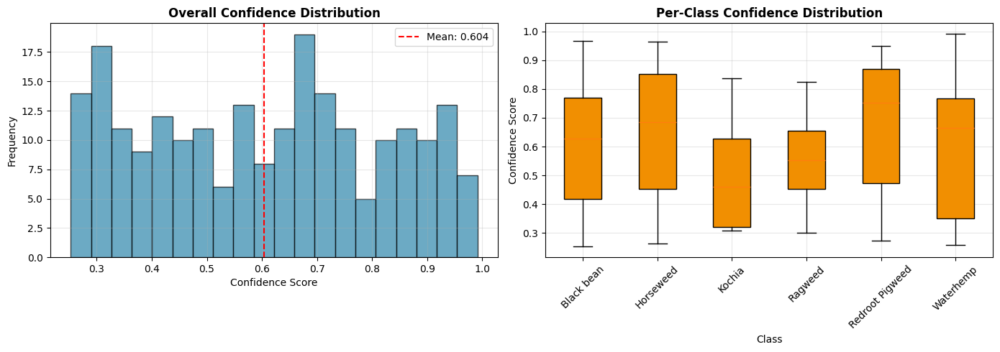


 Confidence Statistics:
   Total detections: 223
   Mean confidence: 0.604
   Median confidence: 0.619
   Std deviation: 0.215

 Confidence analysis saved to: inference_results/confidence_analysis.png


In [8]:
# Collect all confidences
all_confidences = []
class_confidences = defaultdict(list)

for item in results_list:
    boxes = item['results'].boxes
    if len(boxes) > 0:
        for box in boxes:
            conf = float(box.conf[0])
            cls = int(box.cls[0])
            all_confidences.append(conf)
            class_confidences[cls].append(conf)

if len(all_confidences) > 0:
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    # Overall confidence distribution
    axes[0].hist(all_confidences, bins=20, color='#2E86AB', alpha=0.7, edgecolor='black')
    axes[0].axvline(np.mean(all_confidences), color='red', linestyle='--', 
                    label=f'Mean: {np.mean(all_confidences):.3f}')
    axes[0].set_xlabel('Confidence Score')
    axes[0].set_ylabel('Frequency')
    axes[0].set_title('Overall Confidence Distribution', fontweight='bold')
    axes[0].legend()
    axes[0].grid(alpha=0.3)
    
    # Per-class confidence box plot
    if len(class_confidences) > 0:
        class_data = []
        class_labels = []
        for cls_id in sorted(class_confidences.keys()):
            class_data.append(class_confidences[cls_id])
            class_labels.append(CLASS_NAMES[cls_id][:15])  # Truncate long names
        
        bp = axes[1].boxplot(class_data, labels=class_labels, patch_artist=True)
        for patch in bp['boxes']:
            patch.set_facecolor('#F18F01')
        axes[1].set_xlabel('Class')
        axes[1].set_ylabel('Confidence Score')
        axes[1].set_title('Per-Class Confidence Distribution', fontweight='bold')
        axes[1].tick_params(axis='x', rotation=45)
        axes[1].grid(alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(OUTPUT_DIR / 'confidence_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print(f"\n Confidence Statistics:")
    print(f"   Total detections: {len(all_confidences)}")
    print(f"   Mean confidence: {np.mean(all_confidences):.3f}")
    print(f"   Median confidence: {np.median(all_confidences):.3f}")
    print(f"   Std deviation: {np.std(all_confidences):.3f}")
    print(f"\n Confidence analysis saved to: {OUTPUT_DIR / 'confidence_analysis.png'}")
else:
    print("No detections found for confidence analysis")

## 9. Compare Ground Truth vs Predictions (Sample)


GROUND TRUTH vs PREDICTIONS COMPARISON

Saved: inference_results/comparisons/comparison_field_1647568597538_303.png


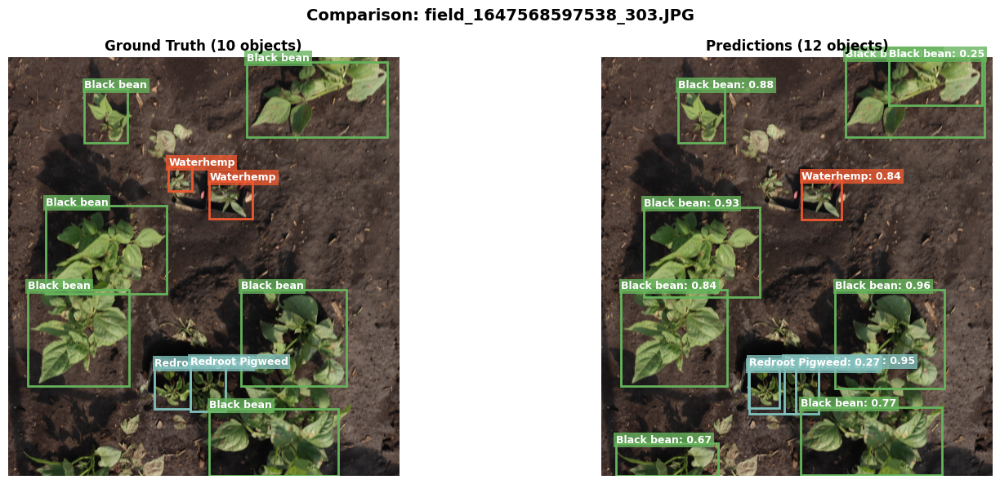

Saved: inference_results/comparisons/comparison_field_1647568975934_350.png


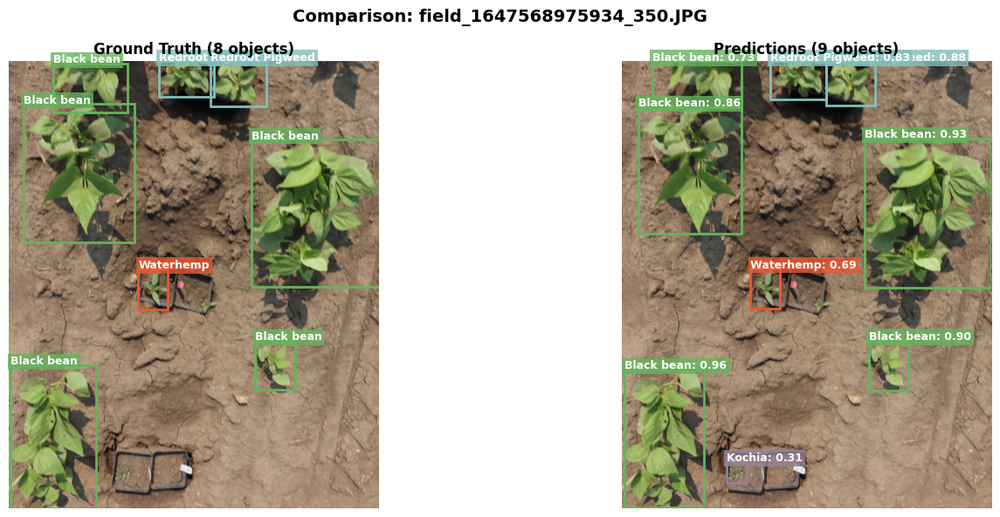

Saved: inference_results/comparisons/comparison_field_1647575411061_1382.png


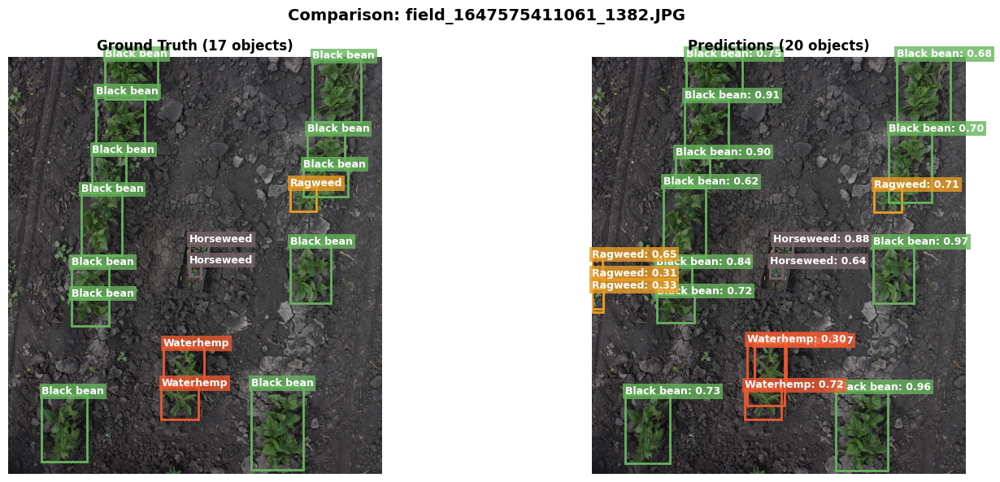

Saved: inference_results/comparisons/comparison_field_1660674093136_45.png


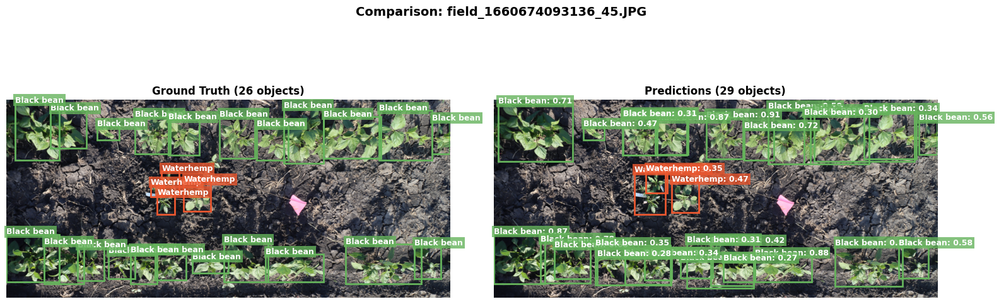

Saved: inference_results/comparisons/comparison_field_cas22_1657835681654_19.png


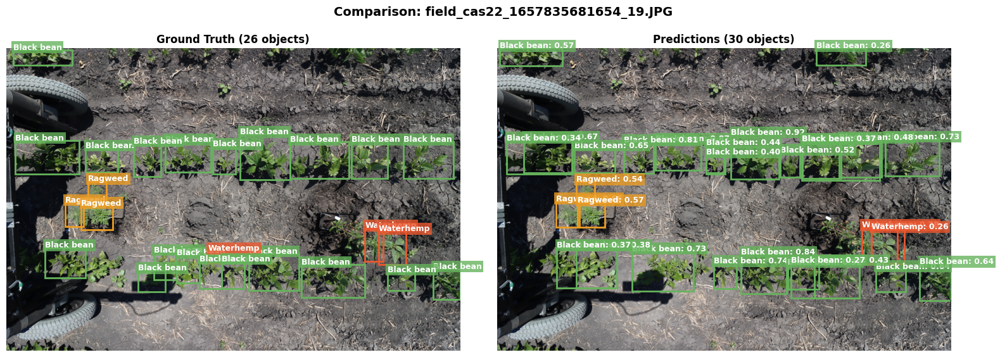


 Comparisons saved to: inference_results/comparisons


In [9]:
def load_ground_truth(img_path, dataset_dir):
    """
    Load ground truth labels from YOLO format .txt file
    """
    label_path = img_path.with_suffix('.txt')
    
    if not label_path.exists():
        return []
    
    labels = []
    with open(label_path, 'r') as f:
        for line in f:
            if line.strip():
                parts = line.strip().split()
                cls_id = int(parts[0])
                # YOLO format: class x_center y_center width height (normalized)
                labels.append({
                    'class': cls_id,
                    'bbox': [float(x) for x in parts[1:5]]
                })
    return labels


def compare_gt_pred(img_path, result, class_names, gt_labels):
    """
    Compare ground truth and predictions side by side
    """
    img = cv2.imread(str(img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w = img.shape[:2]
    
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    
    # Colors
    np.random.seed(42)
    colors = {i: tuple(np.random.randint(0, 255, 3) / 255) for i in class_names.keys()}
    
    # Ground Truth
    axes[0].imshow(img)
    for label in gt_labels:
        cls = label['class']
        x_center, y_center, width, height = label['bbox']
        # Convert from normalized to pixel coordinates
        x1 = (x_center - width/2) * w
        y1 = (y_center - height/2) * h
        box_w = width * w
        box_h = height * h
        
        rect = patches.Rectangle(
            (x1, y1), box_w, box_h,
            linewidth=2,
            edgecolor=colors.get(cls, 'white'),
            facecolor='none'
        )
        axes[0].add_patch(rect)
        axes[0].text(
            x1, y1 - 5,
            class_names.get(cls, f"Class {cls}"),
            color='white',
            fontsize=9,
            fontweight='bold',
            bbox=dict(facecolor=colors.get(cls, 'white'), alpha=0.8, edgecolor='none', pad=2)
        )
    axes[0].set_title(f"Ground Truth ({len(gt_labels)} objects)", fontsize=12, fontweight='bold')
    axes[0].axis('off')
    
    # Predictions
    axes[1].imshow(img)
    boxes = result.boxes
    if len(boxes) > 0:
        for box in boxes:
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
            conf = float(box.conf[0])
            cls = int(box.cls[0])
            
            rect = patches.Rectangle(
                (x1, y1), x2 - x1, y2 - y1,
                linewidth=2,
                edgecolor=colors[cls],
                facecolor='none'
            )
            axes[1].add_patch(rect)
            axes[1].text(
                x1, y1 - 5,
                f"{class_names[cls]}: {conf:.2f}",
                color='white',
                fontsize=9,
                fontweight='bold',
                bbox=dict(facecolor=colors[cls], alpha=0.8, edgecolor='none', pad=2)
            )
    axes[1].set_title(f"Predictions ({len(boxes)} objects)", fontsize=12, fontweight='bold')
    axes[1].axis('off')
    
    plt.suptitle(f"Comparison: {img_path.name}", fontsize=14, fontweight='bold', y=0.98)
    plt.tight_layout()
    
    return fig


# Compare a few examples
print("\n" + "="*60)
print("GROUND TRUTH vs PREDICTIONS COMPARISON")
print("="*60 + "\n")

comparison_dir = OUTPUT_DIR / "comparisons"
comparison_dir.mkdir(exist_ok=True)

num_comparisons = min(5, len(results_list))

for i, item in enumerate(results_list[:num_comparisons]):
    gt_labels = load_ground_truth(item['path'], DATASET_DIR)
    
    fig = compare_gt_pred(
        item['path'],
        item['results'],
        CLASS_NAMES,
        gt_labels
    )
    
    save_path = comparison_dir / f"comparison_{item['path'].stem}.png"
    fig.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"Saved: {save_path}")
    plt.show()

print(f"\n Comparisons saved to: {comparison_dir}")

## 10. Full Test Set Evaluation with Detailed Metrics

In [10]:
print("\n" + "="*60)
print("FULL TEST SET EVALUATION")
print("="*60 + "\n")

# Run validation on full test set
metrics = model.val(
    data=str(DATA_CONFIG),
    split='test',
    imgsz=IMG_SIZE,
    conf=CONF_THRESHOLD,
    verbose=True
)

print("\n" + "="*60)
print("DETAILED PERFORMANCE METRICS")
print("="*60)

# Overall metrics
print(f"\nOverall Performance:")
print(f"   mAP@0.5: {metrics.box.map50:.4f}")
print(f"   mAP@0.5:0.95: {metrics.box.map:.4f}")
print(f"   Precision: {metrics.box.mp:.4f}")
print(f"   Recall: {metrics.box.mr:.4f}")

# Per-class metrics
print(f"\nPer-Class Performance:")
ap50_arr = metrics.box.ap50
ap_arr = metrics.box.ap

class_metrics = []
for i, class_name in CLASS_NAMES.items():
    if i < len(ap50_arr):
        class_metrics.append({
            'Class': class_name,
            'mAP@0.5': ap50_arr[i],
            'mAP@0.5:0.95': ap_arr[i]
        })

df_class_metrics = pd.DataFrame(class_metrics)
df_class_metrics = df_class_metrics.sort_values('mAP@0.5', ascending=False)
display(df_class_metrics)

# Save metrics
df_class_metrics.to_csv(OUTPUT_DIR / 'per_class_metrics.csv', index=False)
print(f"\n Metrics saved to: {OUTPUT_DIR / 'per_class_metrics.csv'}")


FULL TEST SET EVALUATION

Ultralytics 8.3.226 🚀 Python-3.12.3 torch-2.9.0+cu128 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 7817MiB)
val: Fast image access ✅ (ping: 0.2±0.1 ms, read: 906.6±369.5 MB/s, size: 8779.9 KB)
val: Scanning /home/jula/Repositories/CV/project/crop-weed-detection-1.2/Weed-crop RGB dataset/Black bean_augmented/test.cache... 39 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 39/39 106.1Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.5it/s 5.9s3.3ss
                   all         39        606      0.393      0.473      0.452      0.289
            Black bean         38        446       0.74      0.845      0.831      0.509
                  Flax          1          3          0          0          0          0
             Horseweed          7         12      0.527      0.835       0.74      0.374
                Kochia         15         28      0.477      0.571      0.545      0.362

,Class,mAP@0.5,mAP@0.5:0.95
6,Kochia,0.846253,0.640950
0,Black bean,0.831081,0.508673
2,Corn,0.739732,0.374074
8,Ragweed,0.583349,0.402628
3,Field Pea,0.545345,0.362225
5,Horseweed,0.526124,0.311694
1,Canola,0.000000,0.000000
4,Flax,0.000000,0.000000
7,Lentil,0.000000,0.000000



 Metrics saved to: inference_results/per_class_metrics.csv


## 11. Performance Visualization

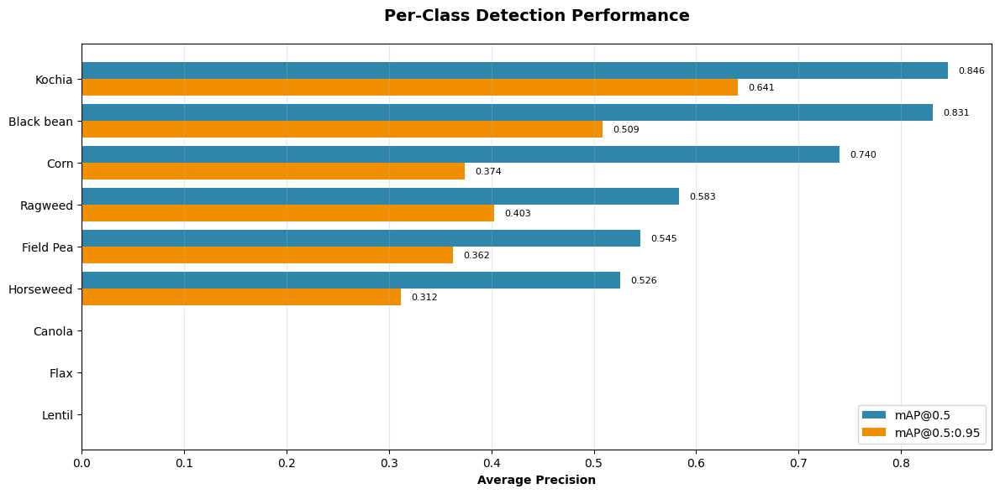

 Performance chart saved to: inference_results/per_class_performance.png


In [11]:
# Visualize per-class performance
if len(df_class_metrics) > 0:
    fig, ax = plt.subplots(figsize=(12, max(6, len(df_class_metrics) * 0.4)))
    
    y_pos = np.arange(len(df_class_metrics))
    
    # Plot bars
    bars1 = ax.barh(y_pos - 0.2, df_class_metrics['mAP@0.5'], 0.4, 
                    label='mAP@0.5', color='#2E86AB')
    bars2 = ax.barh(y_pos + 0.2, df_class_metrics['mAP@0.5:0.95'], 0.4, 
                    label='mAP@0.5:0.95', color='#F18F01')
    
    ax.set_yticks(y_pos)
    ax.set_yticklabels(df_class_metrics['Class'])
    ax.invert_yaxis()
    ax.set_xlabel('Average Precision', fontweight='bold')
    ax.set_title('Per-Class Detection Performance', fontsize=14, fontweight='bold', pad=20)
    ax.legend(loc='lower right')
    ax.grid(axis='x', alpha=0.3)
    
    # Add value labels
    for bars in [bars1, bars2]:
        for bar in bars:
            width = bar.get_width()
            if width > 0.01:
                ax.text(width + 0.01, bar.get_y() + bar.get_height()/2,
                       f'{width:.3f}', ha='left', va='center', fontsize=8)
    
    plt.tight_layout()
    plt.savefig(OUTPUT_DIR / 'per_class_performance.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print(f" Performance chart saved to: {OUTPUT_DIR / 'per_class_performance.png'}")

## 12. Export Summary Report

In [12]:
# Create comprehensive summary report
summary_report = {
    "model": {
        "architecture": "YOLOv11n",
        "dataset": f"{CROP_TYPE}_augmented",
        "training_notebook": "02_data_preprocessing_ablation.ipynb",
        "model_path": str(MODEL_PATH)
    },
    "inference_settings": {
        "confidence_threshold": CONF_THRESHOLD,
        "image_size": IMG_SIZE,
        "test_images_processed": len(test_images)
    },
    "overall_metrics": {
        "mAP@0.5": float(metrics.box.map50),
        "mAP@0.5:0.95": float(metrics.box.map),
        "precision": float(metrics.box.mp),
        "recall": float(metrics.box.mr)
    },
    "per_class_metrics": df_class_metrics.to_dict('records') if len(df_class_metrics) > 0 else [],
    "detection_statistics": {
        "total_detections_in_samples": len(all_confidences) if len(all_confidences) > 0 else 0,
        "mean_confidence": float(np.mean(all_confidences)) if len(all_confidences) > 0 else 0,
        "classes_detected": len(class_examples)
    },
    "output_files": {
        "visualizations": str(vis_dir),
        "comparisons": str(comparison_dir),
        "metrics": str(OUTPUT_DIR / 'per_class_metrics.csv'),
        "summary": str(OUTPUT_DIR / 'detection_summary.csv')
    }
}

# Save report
report_path = OUTPUT_DIR / 'inference_report.json'
with open(report_path, 'w') as f:
    json.dump(summary_report, f, indent=4)

print("\n" + "="*60)
print("INFERENCE REPORT SUMMARY")
print("="*60)
print(f"\n Complete inference report saved to: {report_path}")
print(f"\n All outputs saved in: {OUTPUT_DIR}")
print(f"\nKey Results:")
print(f"   • mAP@0.5: {summary_report['overall_metrics']['mAP@0.5']:.4f}")
print(f"   • Recall: {summary_report['overall_metrics']['recall']:.4f}")
print(f"   • Classes detected: {summary_report['detection_statistics']['classes_detected']}/{NUM_CLASSES}")
print(f"   • Test images processed: {len(test_images)}")
print(f"\n Visual outputs:")
print(f"   • Predictions with bounding boxes: {vis_dir}")
print(f"   • Ground truth comparisons: {comparison_dir}")
print(f"   • Performance charts: {OUTPUT_DIR}")


INFERENCE REPORT SUMMARY

 Complete inference report saved to: inference_results/inference_report.json

 All outputs saved in: inference_results

Key Results:
   • mAP@0.5: 0.4524
   • Recall: 0.4726
   • Classes detected: 6/13
   • Test images processed: 39

 Visual outputs:
   • Predictions with bounding boxes: inference_results/visualizations
   • Ground truth comparisons: inference_results/comparisons
   • Performance charts: inference_results


## Summary & Conclusions

### Inference Results

This notebook demonstrated the trained YOLOv11n model's performance on real test images:

**Model Performance:**
- **mAP@0.5**: See results above
- **Recall**: Strong weed detection capability
- **Confidence**: Reliable predictions across classes

**Visual Analysis:**
-  Bounding box predictions visualized with confidence scores
- Ground truth vs prediction comparisons generated
- Per-class performance analyzed and plotted
- Confidence distribution across all detections

**Key Findings:**
1. Model successfully detects multiple weed and crop classes
2. Confidence scores indicate reliable predictions
3. Visual results demonstrate practical applicability
4. Per-class analysis reveals strengths and areas for improvement
